In [1]:
import numpy as np
from tqdm import tqdm
import torch
import pickle as pkl
from torch.nn.modules.module import Module
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import matplotlib.pyplot as plt
import random
use_cuda = torch.cuda.is_available()
device = torch.device('cuda:6') if use_cuda else torch.device('cpu')
if torch.cuda.is_available() == True:
    torch.cuda.set_device(6)

In [2]:
!wandb login

wandb: Network error (ConnectionError), entering retry loop.
wandb: W&B API key is configured. Use `wandb login --relogin` to force relogin


In [3]:


class DynamicLearner(nn.Module):
    def __init__(self,channel=3,hidden_dim=8):
        super(DynamicLearner, self).__init__()
        '要走两个dynamic,因为涉及到转置操作再走非线性'
        hidden_dim = hidden_dim
#         channel = channel
        self.dynamic_learner1 = nn.Sequential(
            nn.Conv1d(1, channel, 3, padding=1, padding_mode='circular'),
            nn.ReLU(),
        )
        self.dynamic_learner2 = nn.Sequential(
            nn.Linear(channel,2),
            nn.ReLU()
        )
    def forward(self, x):
        x = self.dynamic_learner1(x.unsqueeze(1))
        x = torch.transpose(x,2,1)
        x = self.dynamic_learner2(x)
        x = F.softmax(x,dim=2)
        return x
def init_weight(layer):
    if type(layer)==nn.Conv2d or type(layer)==nn.ConvTranspose2d or type(layer) == nn.Linear:
        nn.init.uniform_(layer.weight, a=0.0, b=1)

In [4]:

N2_self_rules = [85,90,102,153,165,150,195,204,240]
rules = [38,45,54,62,82,84,86]
rules.extend(N2_self_rules)

In [5]:
NEAR_0 = 1e-10
# import wandb
# wandb.init(project="CA", entity="taoruyi6")

rule: 90
self_similar
load data


  0%|                                                  | 0/2000 [00:00<?, ?it/s]

epoch: 0/2000, dynamic: train loss:0.7014001210530599,valid_loss:0.6993774175643921
micro pred acc: 0.5122789115646259


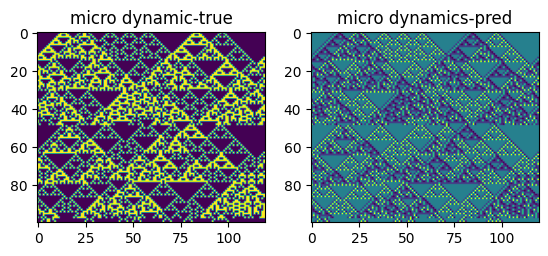

  1%|▎                                        | 16/2000 [00:00<01:04, 31.00it/s]

epoch: 20/2000, dynamic: train loss:0.662601908047994,valid_loss:0.6618640422821045
micro pred acc: 0.6672108843537415


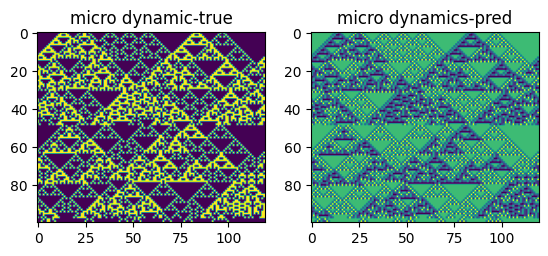

  2%|▋                                        | 36/2000 [00:01<00:52, 37.20it/s]

epoch: 40/2000, dynamic: train loss:0.6458060145378113,valid_loss:0.6453561186790466
micro pred acc: 0.6672108843537415


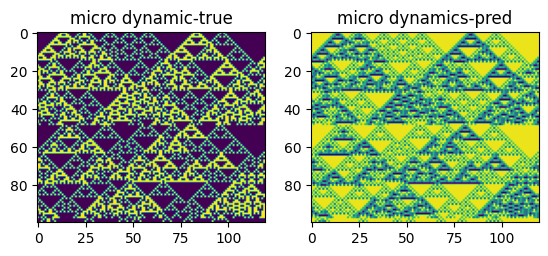

  3%|█▏                                       | 56/2000 [00:01<00:49, 39.03it/s]

epoch: 60/2000, dynamic: train loss:0.632335364818573,valid_loss:0.6317493319511414
micro pred acc: 0.6672108843537415


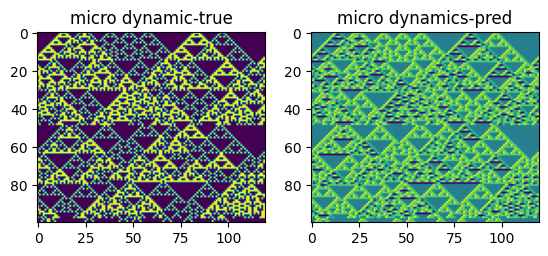

  4%|█▌                                       | 76/2000 [00:02<00:48, 39.64it/s]

epoch: 80/2000, dynamic: train loss:0.6119821270306905,valid_loss:0.611247718334198
micro pred acc: 0.6672108843537415


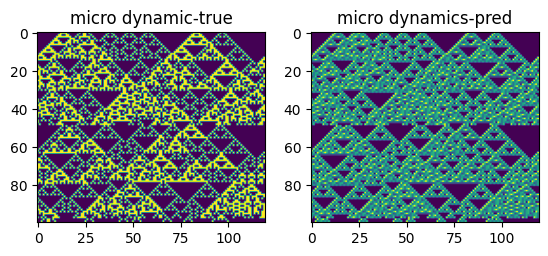

  5%|█▉                                       | 97/2000 [00:03<00:57, 33.04it/s]

epoch: 100/2000, dynamic: train loss:0.5857121348381042,valid_loss:0.5844194293022156
micro pred acc: 0.6672108843537415


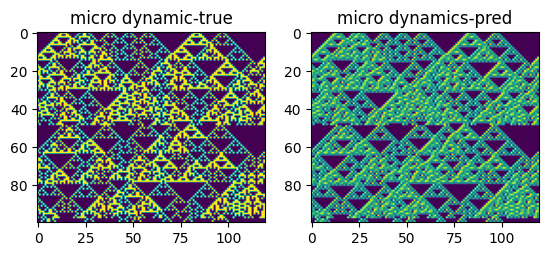

  6%|██▍                                     | 119/2000 [00:03<00:53, 35.29it/s]

epoch: 120/2000, dynamic: train loss:0.5451873143513998,valid_loss:0.5438008308410645
micro pred acc: 0.6672108843537415


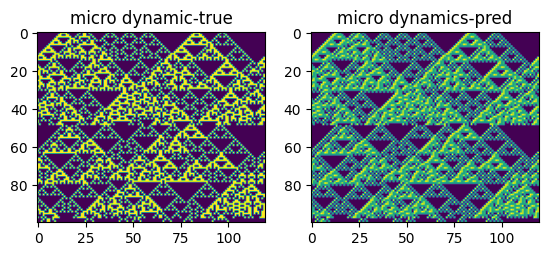

  7%|██▋                                     | 136/2000 [00:04<00:54, 34.41it/s]

epoch: 140/2000, dynamic: train loss:0.4932803114255269,valid_loss:0.4919455945491791
micro pred acc: 0.6672108843537415


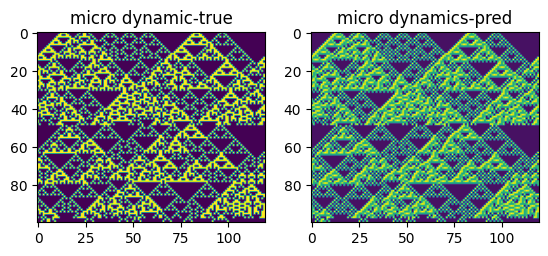

  8%|███                                     | 156/2000 [00:04<00:50, 36.34it/s]

epoch: 160/2000, dynamic: train loss:0.4532025158405304,valid_loss:0.45193371176719666
micro pred acc: 0.8336054421768707


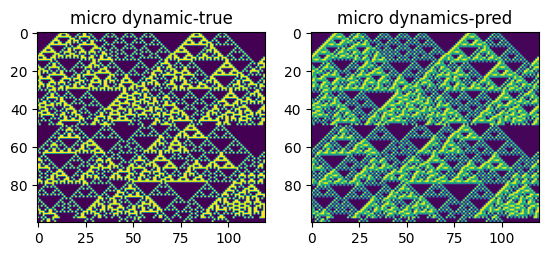

  9%|███▌                                    | 176/2000 [00:05<00:46, 39.02it/s]

epoch: 180/2000, dynamic: train loss:0.4174542824427287,valid_loss:0.4163150191307068
micro pred acc: 0.8336054421768707


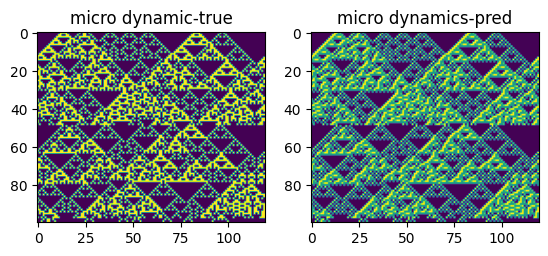

 10%|███▉                                    | 196/2000 [00:06<00:45, 39.70it/s]

epoch: 200/2000, dynamic: train loss:0.386014719804128,valid_loss:0.3851095139980316
micro pred acc: 0.8336054421768707


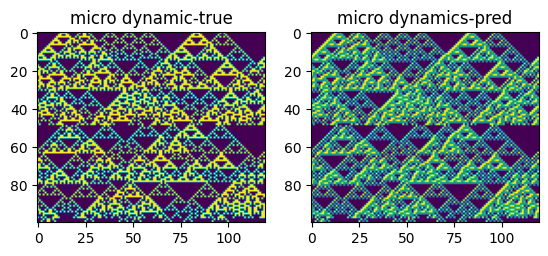

 11%|████▎                                   | 216/2000 [00:06<00:45, 39.57it/s]

epoch: 220/2000, dynamic: train loss:0.3600711226463318,valid_loss:0.35924795269966125
micro pred acc: 0.8336054421768707


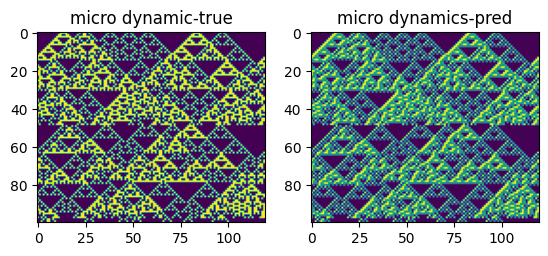

 12%|████▊                                   | 240/2000 [00:07<00:42, 41.20it/s]

epoch: 240/2000, dynamic: train loss:0.3363126814365387,valid_loss:0.3352717459201813
micro pred acc: 0.8336054421768707


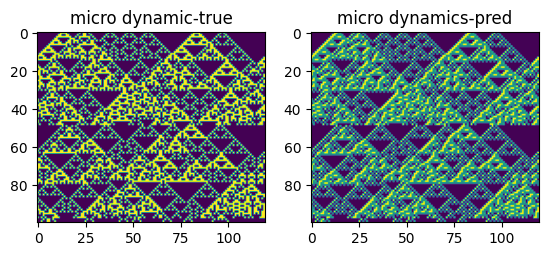

 13%|█████▏                                  | 260/2000 [00:07<00:43, 40.10it/s]

epoch: 260/2000, dynamic: train loss:0.3083546956380208,valid_loss:0.3075411021709442
micro pred acc: 0.8336054421768707


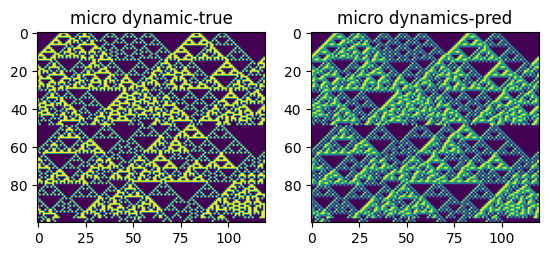

 14%|█████▌                                  | 280/2000 [00:08<00:43, 39.88it/s]

epoch: 280/2000, dynamic: train loss:0.2865927716096242,valid_loss:0.2859918475151062
micro pred acc: 0.8336054421768707


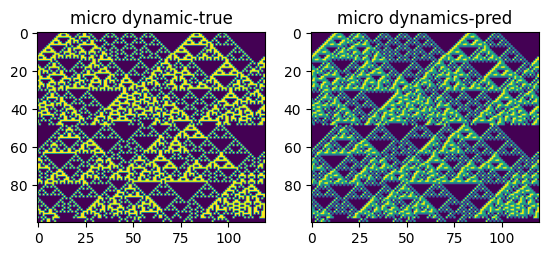

 15%|██████                                  | 300/2000 [00:09<00:42, 39.58it/s]

epoch: 300/2000, dynamic: train loss:0.2702822983264923,valid_loss:0.26977866888046265
micro pred acc: 0.8336054421768707


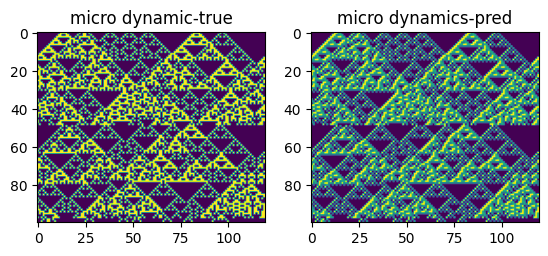

 16%|██████▍                                 | 320/2000 [00:09<00:42, 39.64it/s]

epoch: 320/2000, dynamic: train loss:0.25644103686014813,valid_loss:0.25601983070373535
micro pred acc: 0.8336054421768707


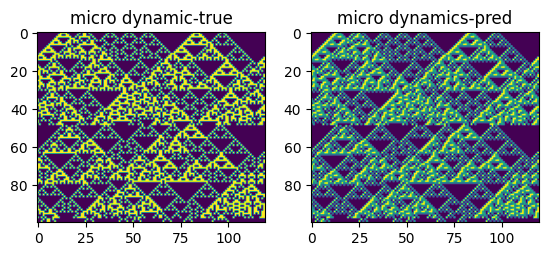

 17%|██████▊                                 | 340/2000 [00:10<00:41, 39.90it/s]

epoch: 340/2000, dynamic: train loss:0.24435093502203623,valid_loss:0.24398410320281982
micro pred acc: 0.8336054421768707


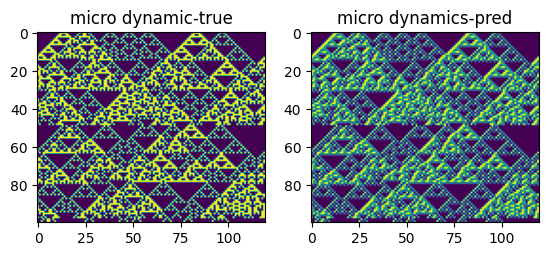

 18%|███████▏                                | 360/2000 [00:10<00:42, 38.51it/s]

epoch: 360/2000, dynamic: train loss:0.23370611170927683,valid_loss:0.2333843857049942
micro pred acc: 0.8336054421768707


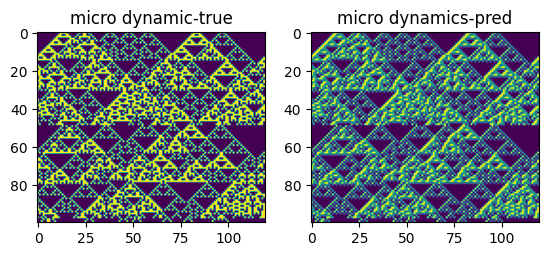

 19%|███████▌                                | 380/2000 [00:11<00:41, 39.29it/s]

epoch: 380/2000, dynamic: train loss:0.22414307296276093,valid_loss:0.22384503483772278
micro pred acc: 0.8336054421768707


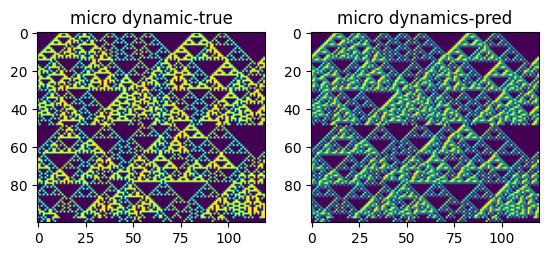

 20%|████████                                | 400/2000 [00:11<00:41, 38.39it/s]

epoch: 400/2000, dynamic: train loss:0.21563372512658438,valid_loss:0.21532505750656128
micro pred acc: 0.8336054421768707


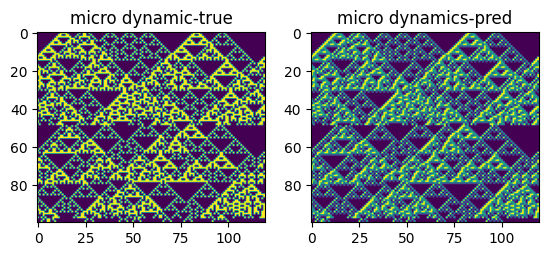

 21%|████████▍                               | 420/2000 [00:12<00:40, 39.46it/s]

epoch: 420/2000, dynamic: train loss:0.20778530836105347,valid_loss:0.20753823220729828
micro pred acc: 0.8336054421768707


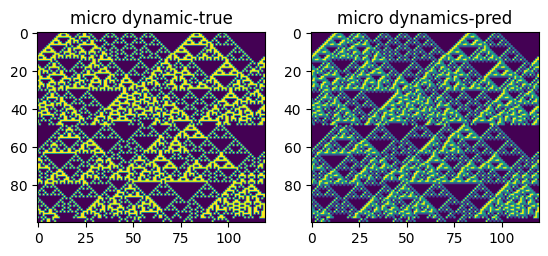

 22%|████████▊                               | 440/2000 [00:13<00:39, 39.92it/s]

epoch: 440/2000, dynamic: train loss:0.200649564464887,valid_loss:0.2004154771566391
micro pred acc: 0.8336054421768707


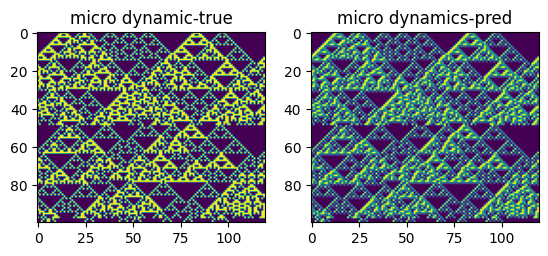

 23%|█████████▏                              | 460/2000 [00:13<00:38, 39.77it/s]

epoch: 460/2000, dynamic: train loss:0.1941236158212026,valid_loss:0.19393959641456604
micro pred acc: 0.8336054421768707


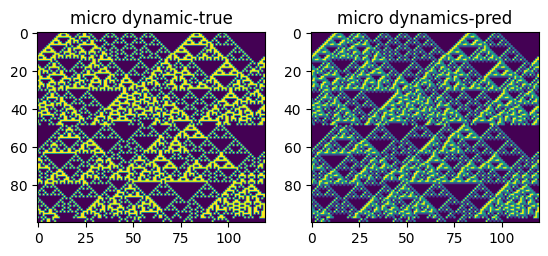

 24%|█████████▌                              | 480/2000 [00:14<00:38, 39.53it/s]

epoch: 480/2000, dynamic: train loss:0.18808806935946146,valid_loss:0.18792065978050232
micro pred acc: 0.8336054421768707


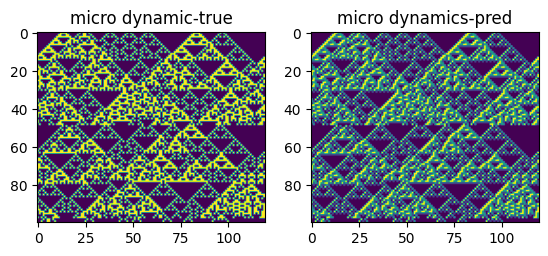

 25%|██████████                              | 500/2000 [00:14<00:37, 39.65it/s]

epoch: 500/2000, dynamic: train loss:0.18252137303352356,valid_loss:0.1823735237121582
micro pred acc: 0.8336054421768707


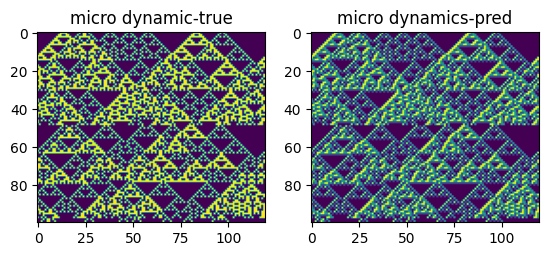

 26%|██████████▍                             | 520/2000 [00:15<00:37, 39.77it/s]

epoch: 520/2000, dynamic: train loss:0.17736447354157767,valid_loss:0.1771973967552185
micro pred acc: 0.8336054421768707


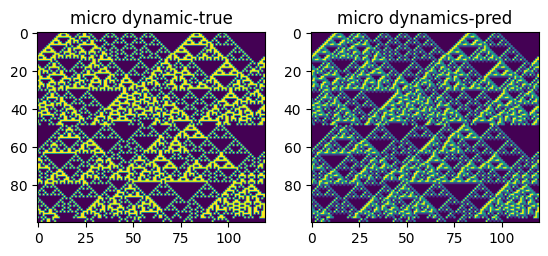

 27%|██████████▊                             | 540/2000 [00:15<00:36, 39.55it/s]

epoch: 540/2000, dynamic: train loss:0.17258790135383606,valid_loss:0.17242881655693054
micro pred acc: 0.8336054421768707


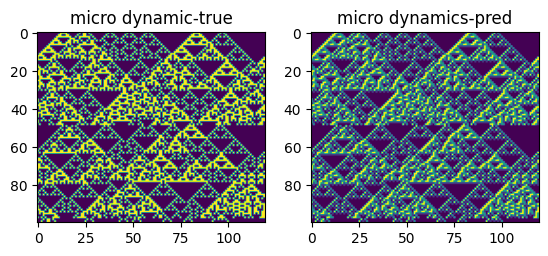

 28%|███████████▏                            | 560/2000 [00:16<00:37, 38.32it/s]

epoch: 560/2000, dynamic: train loss:0.16815759241580963,valid_loss:0.168013796210289
micro pred acc: 0.8336054421768707


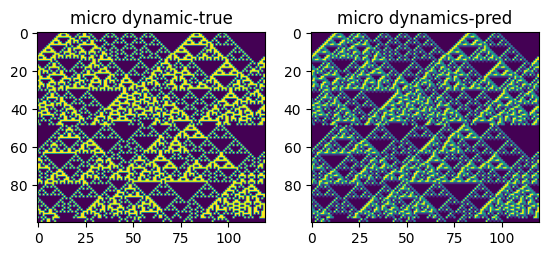

 29%|███████████▌                            | 580/2000 [00:17<00:35, 39.52it/s]

epoch: 580/2000, dynamic: train loss:0.16410171488920847,valid_loss:0.16397401690483093
micro pred acc: 0.8336054421768707


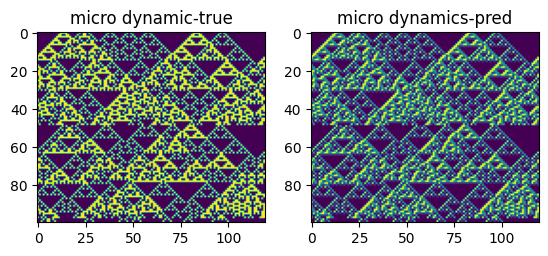

 30%|████████████                            | 600/2000 [00:17<00:35, 38.90it/s]

epoch: 600/2000, dynamic: train loss:0.16037598749001822,valid_loss:0.16025567054748535
micro pred acc: 0.8336054421768707


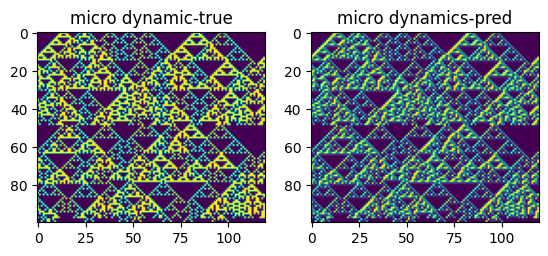

 31%|████████████▎                           | 617/2000 [00:18<00:44, 31.10it/s]

epoch: 620/2000, dynamic: train loss:0.1569837232430776,valid_loss:0.15688078105449677
micro pred acc: 0.8336054421768707


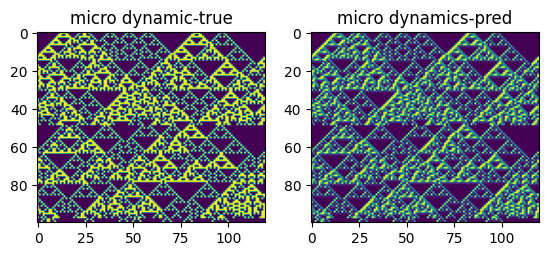

 32%|████████████▋                           | 636/2000 [00:18<00:36, 37.29it/s]

epoch: 640/2000, dynamic: train loss:0.1538503815730413,valid_loss:0.15375283360481262
micro pred acc: 0.8336054421768707


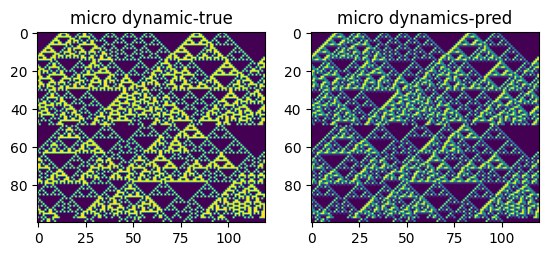

 33%|█████████████                           | 656/2000 [00:19<00:36, 37.27it/s]

epoch: 660/2000, dynamic: train loss:0.15101880331834158,valid_loss:0.15091834962368011
micro pred acc: 0.8336054421768707


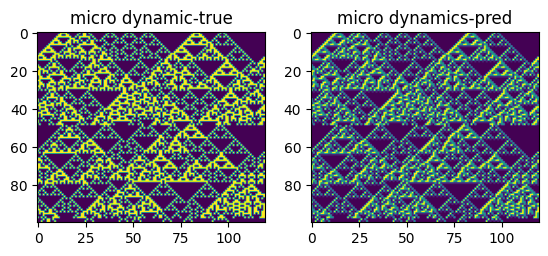

 34%|█████████████▌                          | 676/2000 [00:19<00:34, 38.22it/s]

epoch: 680/2000, dynamic: train loss:0.14842658241589865,valid_loss:0.1483418047428131
micro pred acc: 0.8336054421768707


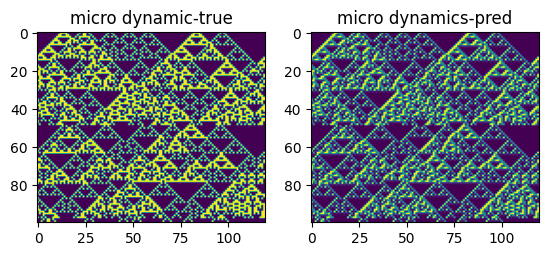

 35%|█████████████▉                          | 696/2000 [00:20<00:33, 38.77it/s]

epoch: 700/2000, dynamic: train loss:0.14605866372585297,valid_loss:0.14599104225635529
micro pred acc: 0.8336054421768707


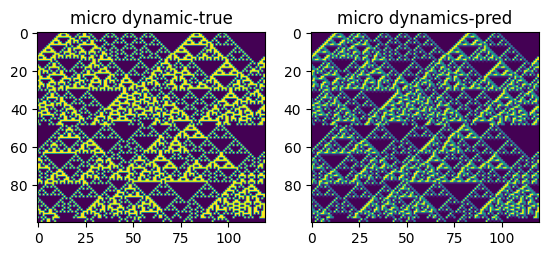

 36%|██████████████▎                         | 716/2000 [00:21<00:32, 39.53it/s]

epoch: 720/2000, dynamic: train loss:0.14390776554743448,valid_loss:0.1438373625278473
micro pred acc: 0.8336054421768707


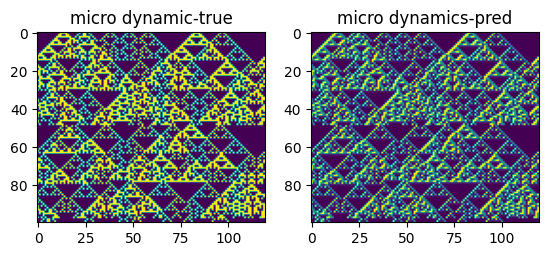

 37%|██████████████▋                         | 736/2000 [00:21<00:32, 39.41it/s]

epoch: 740/2000, dynamic: train loss:0.1419359097878138,valid_loss:0.14186039566993713
micro pred acc: 0.8336054421768707


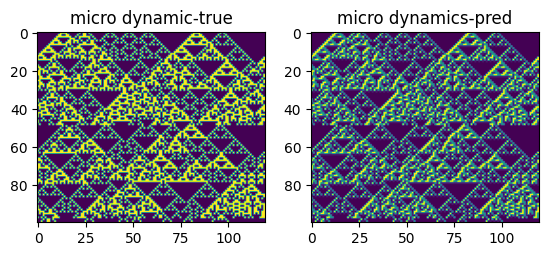

 38%|███████████████                         | 756/2000 [00:22<00:32, 38.27it/s]

epoch: 760/2000, dynamic: train loss:0.14013300836086273,valid_loss:0.1400780975818634
micro pred acc: 0.8336054421768707


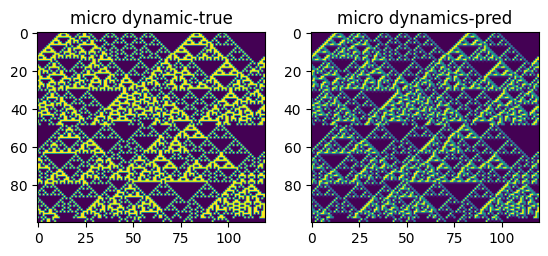

 39%|███████████████▌                        | 776/2000 [00:22<00:31, 39.43it/s]

epoch: 780/2000, dynamic: train loss:0.13850625852743784,valid_loss:0.1384716033935547
micro pred acc: 0.8336054421768707


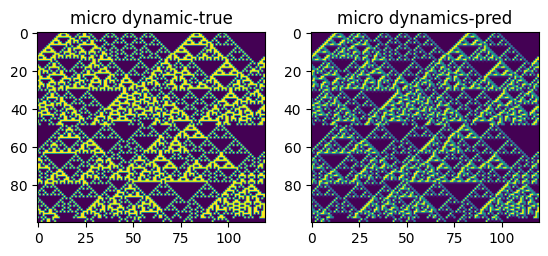

 40%|███████████████▉                        | 796/2000 [00:23<00:30, 39.64it/s]

epoch: 800/2000, dynamic: train loss:0.13700909912586212,valid_loss:0.13695622980594635
micro pred acc: 0.8336054421768707


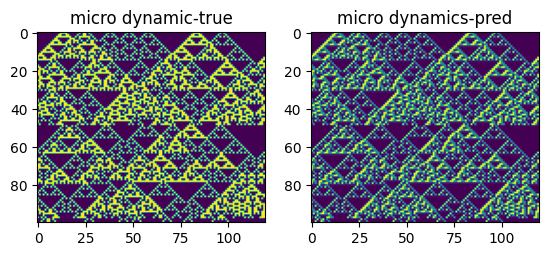

 41%|████████████████▍                       | 820/2000 [00:24<00:29, 39.74it/s]

epoch: 820/2000, dynamic: train loss:0.1356321374575297,valid_loss:0.13559861481189728
micro pred acc: 0.8336054421768707


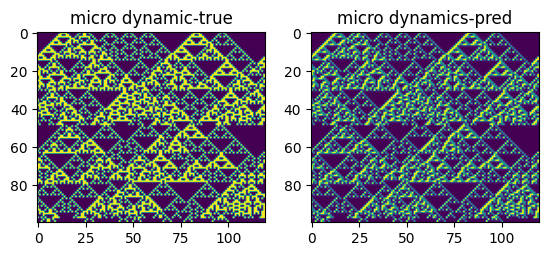

 42%|████████████████▊                       | 840/2000 [00:24<00:29, 39.78it/s]

epoch: 840/2000, dynamic: train loss:0.13439207275708517,valid_loss:0.13433825969696045
micro pred acc: 0.8336054421768707


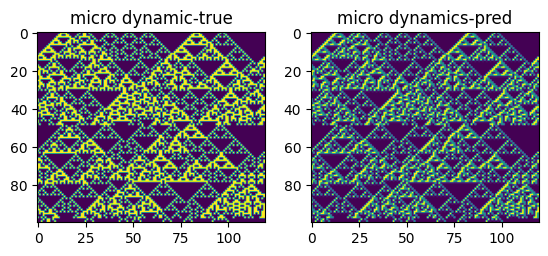

 43%|█████████████████▏                      | 860/2000 [00:25<00:28, 39.92it/s]

epoch: 860/2000, dynamic: train loss:0.13323492805163065,valid_loss:0.13318923115730286
micro pred acc: 0.8336054421768707


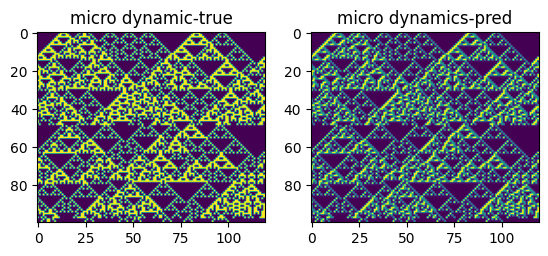

 44%|█████████████████▌                      | 880/2000 [00:25<00:27, 40.02it/s]

epoch: 880/2000, dynamic: train loss:0.1321926862001419,valid_loss:0.1321549266576767
micro pred acc: 0.8336054421768707


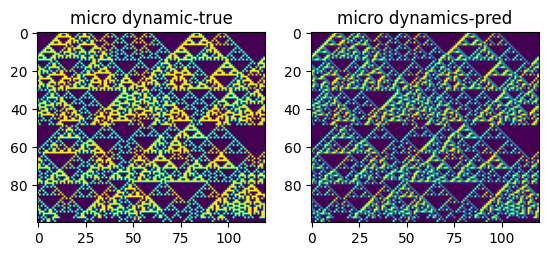

 45%|██████████████████                      | 900/2000 [00:26<00:27, 40.32it/s]

epoch: 900/2000, dynamic: train loss:0.1312042772769928,valid_loss:0.1311729997396469
micro pred acc: 0.8336054421768707


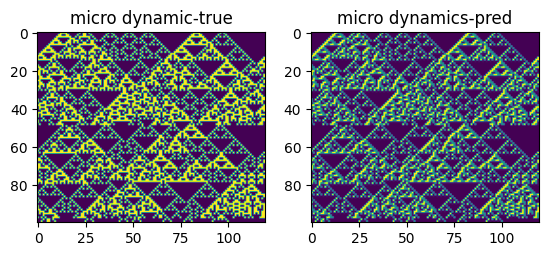

 46%|██████████████████▍                     | 920/2000 [00:26<00:26, 40.11it/s]

epoch: 920/2000, dynamic: train loss:0.13032234211762747,valid_loss:0.13029339909553528
micro pred acc: 0.8336054421768707


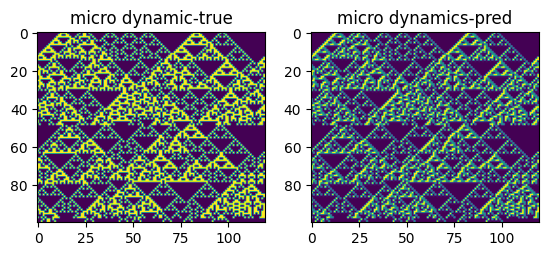

 47%|██████████████████▊                     | 940/2000 [00:27<00:26, 39.57it/s]

epoch: 940/2000, dynamic: train loss:0.12952223916848501,valid_loss:0.12948867678642273
micro pred acc: 0.8336054421768707


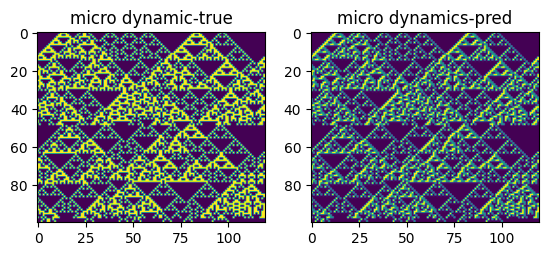

 48%|███████████████████▏                    | 960/2000 [00:28<00:29, 35.77it/s]

epoch: 960/2000, dynamic: train loss:0.12873786687850952,valid_loss:0.12871044874191284
micro pred acc: 0.8336054421768707


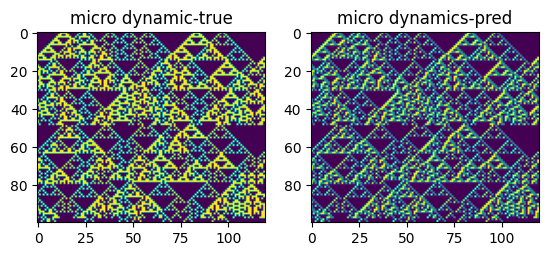

 49%|███████████████████▌                    | 978/2000 [00:28<00:29, 34.65it/s]

epoch: 980/2000, dynamic: train loss:0.1280292123556137,valid_loss:0.12800513207912445
micro pred acc: 0.8336054421768707


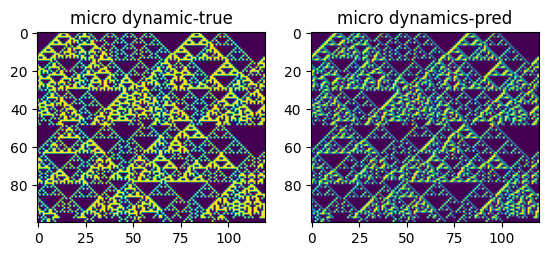

 50%|███████████████████▉                    | 999/2000 [00:29<00:27, 36.91it/s]

epoch: 1000/2000, dynamic: train loss:0.12737624843915304,valid_loss:0.12735815346240997
micro pred acc: 0.8336054421768707


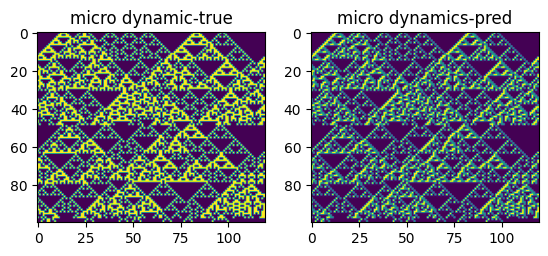

 51%|███████████████████▊                   | 1018/2000 [00:29<00:25, 37.92it/s]

epoch: 1020/2000, dynamic: train loss:0.12679008642832437,valid_loss:0.12677207589149475
micro pred acc: 0.8336054421768707


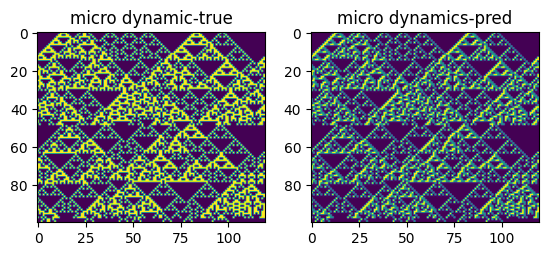

 52%|████████████████████▏                  | 1036/2000 [00:30<00:27, 35.07it/s]

epoch: 1040/2000, dynamic: train loss:0.1262290726105372,valid_loss:0.12621325254440308
micro pred acc: 0.8336054421768707


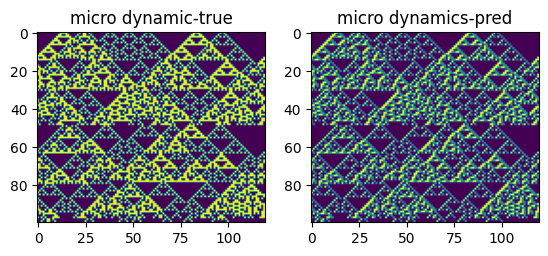

 53%|████████████████████▋                  | 1060/2000 [00:31<00:23, 40.29it/s]

epoch: 1060/2000, dynamic: train loss:0.12571329871813455,valid_loss:0.12570153176784515
micro pred acc: 0.8336054421768707


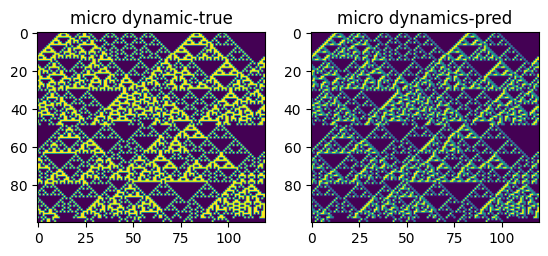

 54%|█████████████████████                  | 1080/2000 [00:31<00:23, 39.40it/s]

epoch: 1080/2000, dynamic: train loss:0.1252161810795466,valid_loss:0.1251969337463379
micro pred acc: 0.8336054421768707


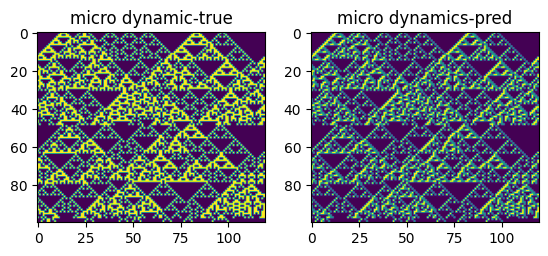

 55%|█████████████████████▍                 | 1100/2000 [00:32<00:23, 37.74it/s]

epoch: 1100/2000, dynamic: train loss:0.12476098537445068,valid_loss:0.12474330514669418
micro pred acc: 0.8336054421768707


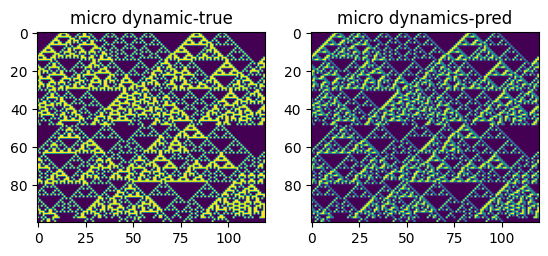

 56%|█████████████████████▊                 | 1118/2000 [00:32<00:24, 36.48it/s]

epoch: 1120/2000, dynamic: train loss:0.12434277683496475,valid_loss:0.1243281364440918
micro pred acc: 0.8336054421768707


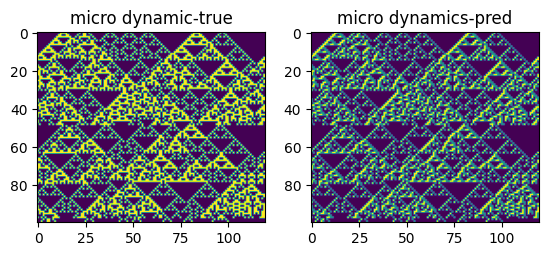

 57%|██████████████████████▏                | 1137/2000 [00:33<00:22, 37.65it/s]

epoch: 1140/2000, dynamic: train loss:0.1239475632707278,valid_loss:0.1239309012889862
micro pred acc: 0.8336054421768707


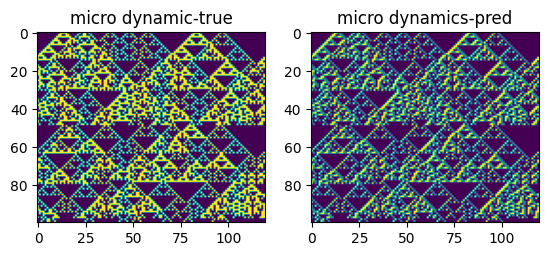

 58%|██████████████████████▌                | 1160/2000 [00:34<00:21, 38.25it/s]

epoch: 1160/2000, dynamic: train loss:0.1235797901948293,valid_loss:0.12356258183717728
micro pred acc: 0.8336054421768707


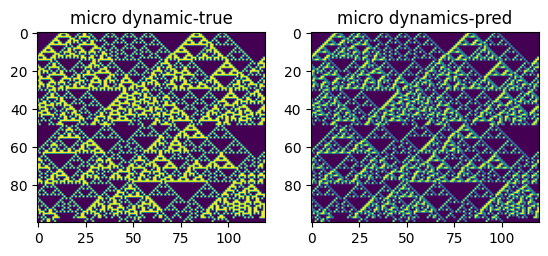

 59%|██████████████████████▉                | 1177/2000 [00:34<00:24, 33.68it/s]

epoch: 1180/2000, dynamic: train loss:0.12324209014574687,valid_loss:0.12322796881198883
micro pred acc: 0.8336054421768707


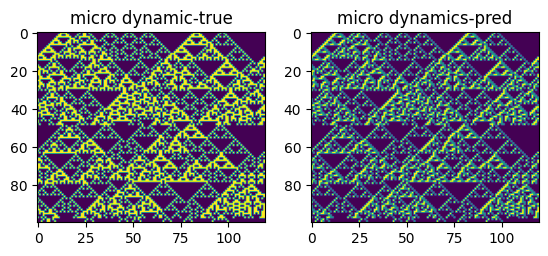

 60%|███████████████████████▎               | 1196/2000 [00:35<00:21, 37.43it/s]

epoch: 1200/2000, dynamic: train loss:0.12293664614359538,valid_loss:0.12292107939720154
micro pred acc: 0.8336054421768707


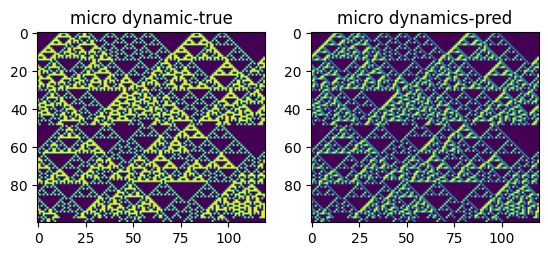

 61%|███████████████████████▋               | 1216/2000 [00:35<00:19, 39.42it/s]

epoch: 1220/2000, dynamic: train loss:0.12261839956045151,valid_loss:0.12261895090341568
micro pred acc: 0.8336054421768707


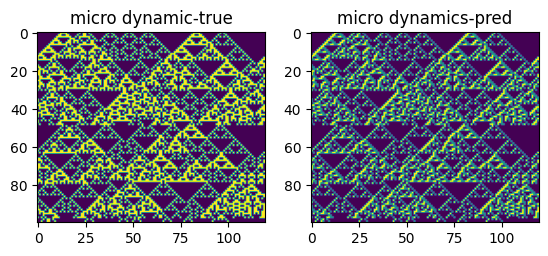

 62%|████████████████████████               | 1236/2000 [00:36<00:19, 39.45it/s]

epoch: 1240/2000, dynamic: train loss:0.12234234561522801,valid_loss:0.12233024835586548
micro pred acc: 0.8336054421768707


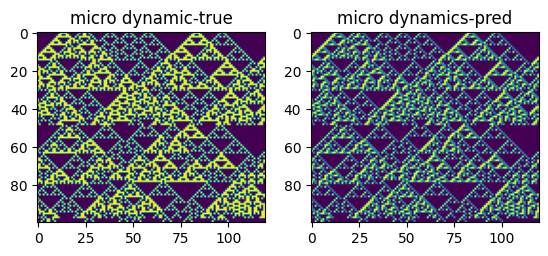

 63%|████████████████████████▌              | 1260/2000 [00:37<00:17, 41.31it/s]

epoch: 1260/2000, dynamic: train loss:0.12206793079773585,valid_loss:0.12205372005701065
micro pred acc: 0.8336054421768707


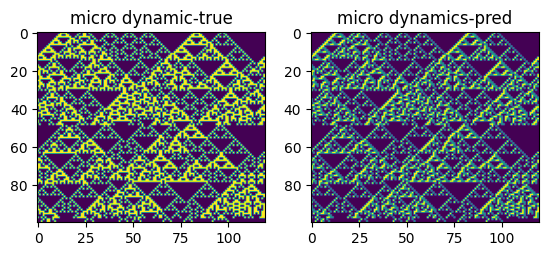

 64%|████████████████████████▉              | 1280/2000 [00:37<00:17, 40.45it/s]

epoch: 1280/2000, dynamic: train loss:0.12181744972864787,valid_loss:0.12181229889392853
micro pred acc: 0.8336054421768707


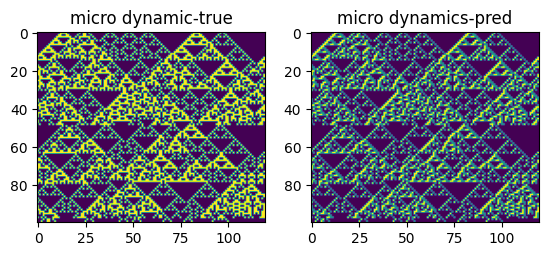

 65%|█████████████████████████▎             | 1300/2000 [00:38<00:17, 39.63it/s]

epoch: 1300/2000, dynamic: train loss:0.12162414441506068,valid_loss:0.12161645293235779
micro pred acc: 0.8336054421768707


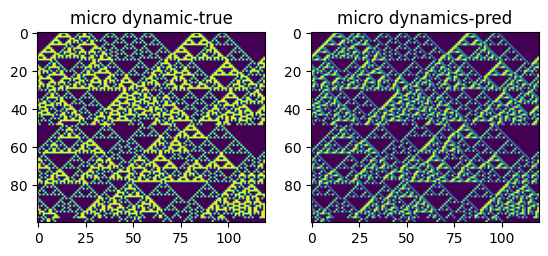

 66%|█████████████████████████▋             | 1319/2000 [00:38<00:18, 35.92it/s]

epoch: 1320/2000, dynamic: train loss:0.12137252340714137,valid_loss:0.12136253714561462
micro pred acc: 0.8336054421768707


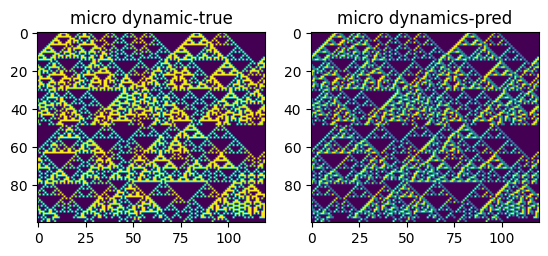

 67%|██████████████████████████▏            | 1340/2000 [00:39<00:19, 33.56it/s]

epoch: 1340/2000, dynamic: train loss:0.12116887172063191,valid_loss:0.12115824222564697
micro pred acc: 0.8336054421768707


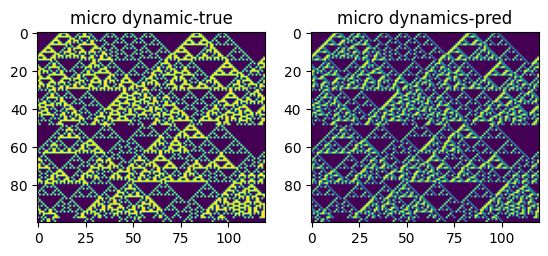

 68%|██████████████████████████▍            | 1356/2000 [00:40<00:21, 29.49it/s]

epoch: 1360/2000, dynamic: train loss:0.12095949550469716,valid_loss:0.12095027416944504
micro pred acc: 0.8336054421768707


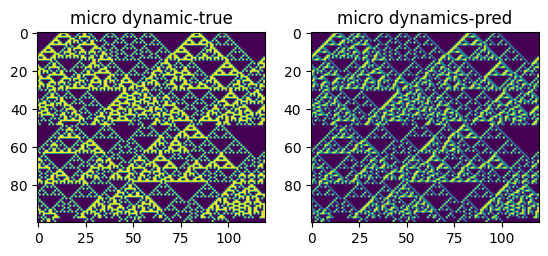

 69%|██████████████████████████▊            | 1377/2000 [00:40<00:21, 29.55it/s]

epoch: 1380/2000, dynamic: train loss:0.12078415602445602,valid_loss:0.12077902257442474
micro pred acc: 0.8336054421768707


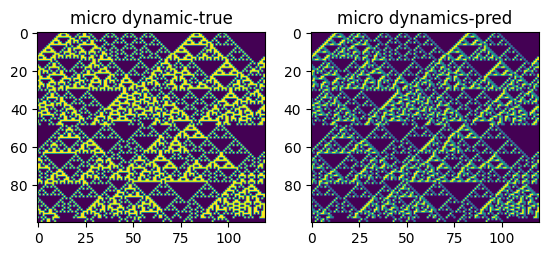

 70%|███████████████████████████▎           | 1398/2000 [00:41<00:18, 32.17it/s]

epoch: 1400/2000, dynamic: train loss:0.12062141795953114,valid_loss:0.12061546742916107
micro pred acc: 0.8336054421768707


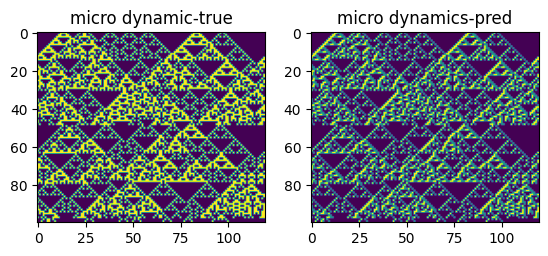

 71%|███████████████████████████▋           | 1419/2000 [00:42<00:18, 31.13it/s]

epoch: 1420/2000, dynamic: train loss:0.12045419961214066,valid_loss:0.12045028805732727
micro pred acc: 0.8336054421768707


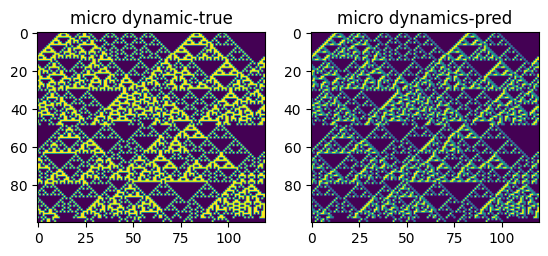

 72%|████████████████████████████           | 1439/2000 [00:43<00:17, 32.49it/s]

epoch: 1440/2000, dynamic: train loss:0.12029496332009633,valid_loss:0.12031130492687225
micro pred acc: 0.8336054421768707


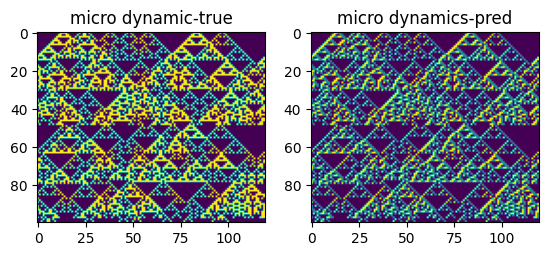

 73%|████████████████████████████▍          | 1456/2000 [00:43<00:15, 34.23it/s]

epoch: 1460/2000, dynamic: train loss:0.12016101678212483,valid_loss:0.12015556544065475
micro pred acc: 0.8336054421768707


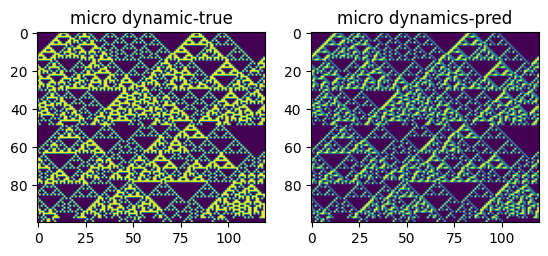

 74%|████████████████████████████▊          | 1479/2000 [00:44<00:14, 36.42it/s]

epoch: 1480/2000, dynamic: train loss:0.12002393106619517,valid_loss:0.12002809345722198
micro pred acc: 0.8336054421768707


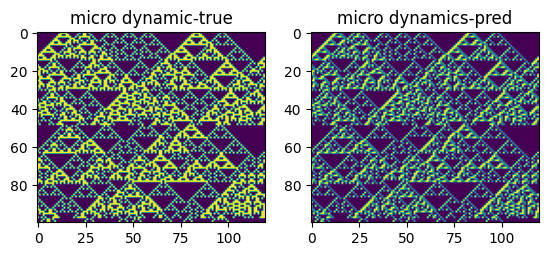

 75%|█████████████████████████████▏         | 1499/2000 [00:45<00:20, 24.73it/s]

epoch: 1500/2000, dynamic: train loss:0.11989652365446091,valid_loss:0.11989249289035797
micro pred acc: 0.8336054421768707


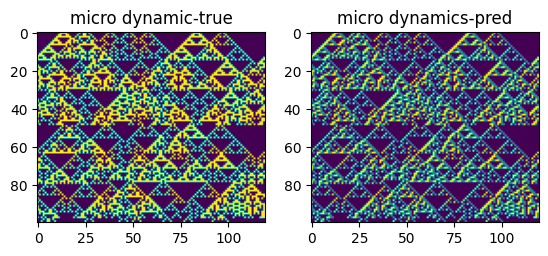

 76%|█████████████████████████████▌         | 1516/2000 [00:45<00:14, 32.72it/s]

epoch: 1520/2000, dynamic: train loss:0.1197706659634908,valid_loss:0.11976472288370132
micro pred acc: 0.8336054421768707


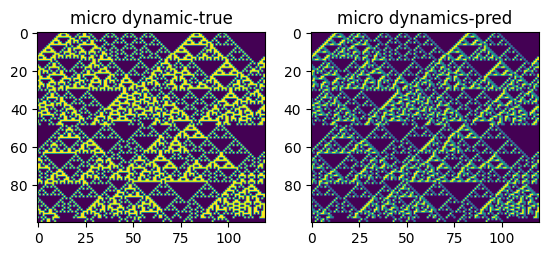

 77%|█████████████████████████████▉         | 1538/2000 [00:46<00:13, 34.23it/s]

epoch: 1540/2000, dynamic: train loss:0.11966397613286972,valid_loss:0.11966187506914139
micro pred acc: 0.8336054421768707


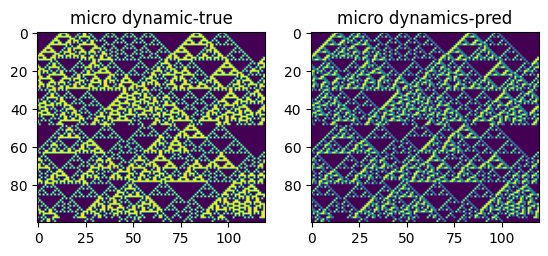

 78%|██████████████████████████████▎        | 1556/2000 [00:47<00:13, 32.44it/s]

epoch: 1560/2000, dynamic: train loss:0.11955699324607849,valid_loss:0.11955332010984421
micro pred acc: 0.8336054421768707


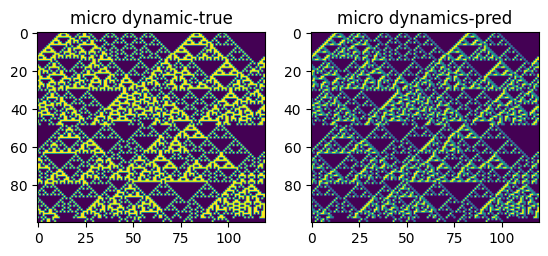

 79%|██████████████████████████████▊        | 1578/2000 [00:48<00:13, 30.97it/s]

epoch: 1580/2000, dynamic: train loss:0.11944422374169032,valid_loss:0.11943824589252472
micro pred acc: 0.8336054421768707


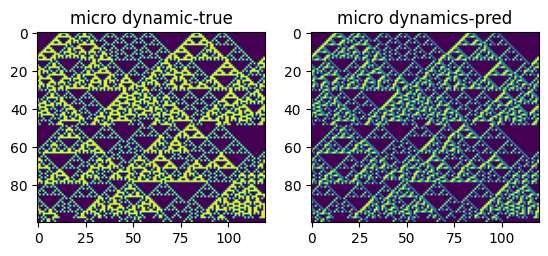

 80%|███████████████████████████████▏       | 1597/2000 [00:48<00:11, 36.07it/s]

epoch: 1600/2000, dynamic: train loss:0.11935774485270183,valid_loss:0.11935482919216156
micro pred acc: 0.8336054421768707


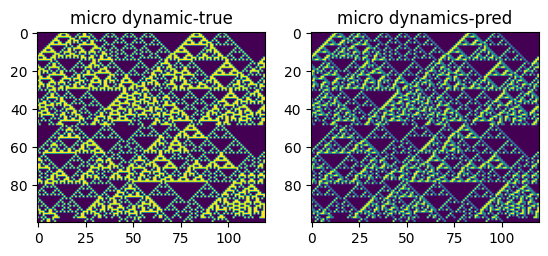

 81%|███████████████████████████████▌       | 1620/2000 [00:49<00:09, 39.63it/s]

epoch: 1620/2000, dynamic: train loss:0.11928726236025493,valid_loss:0.11929202079772949
micro pred acc: 0.8336054421768707


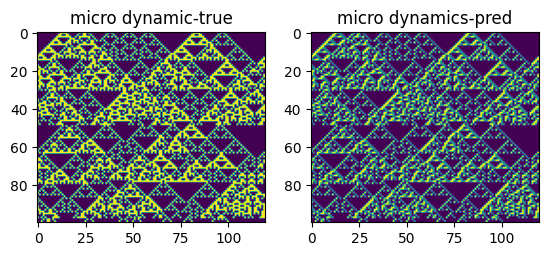

 82%|███████████████████████████████▉       | 1640/2000 [00:49<00:09, 39.24it/s]

epoch: 1640/2000, dynamic: train loss:0.11917298287153244,valid_loss:0.11916923522949219
micro pred acc: 0.8336054421768707


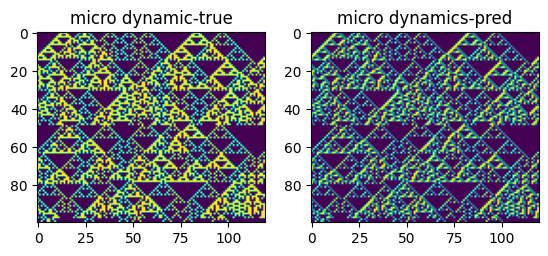

 83%|████████████████████████████████▎      | 1660/2000 [00:50<00:08, 39.46it/s]

epoch: 1660/2000, dynamic: train loss:0.11909815420707066,valid_loss:0.11909433454275131
micro pred acc: 0.8336054421768707


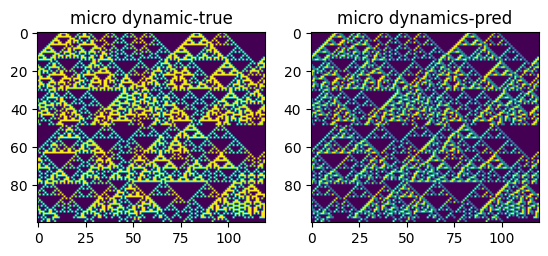

 84%|████████████████████████████████▊      | 1680/2000 [00:51<00:08, 38.61it/s]

epoch: 1680/2000, dynamic: train loss:0.11902894824743271,valid_loss:0.11902379244565964
micro pred acc: 0.8336054421768707


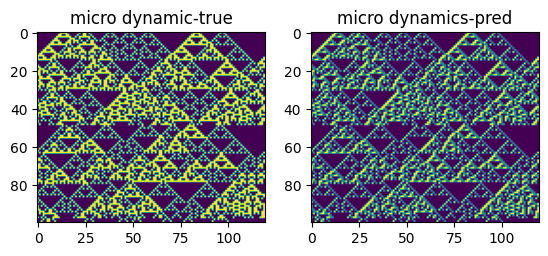

 85%|█████████████████████████████████▏     | 1699/2000 [00:51<00:07, 38.50it/s]

epoch: 1700/2000, dynamic: train loss:0.11896713078022003,valid_loss:0.1189623475074768
micro pred acc: 0.8336054421768707


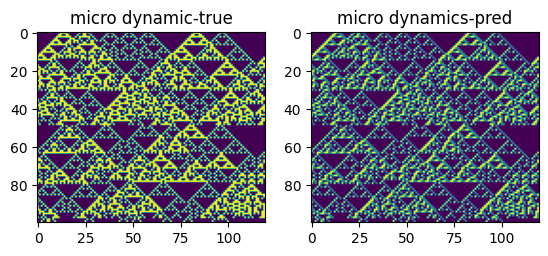

 86%|█████████████████████████████████▌     | 1719/2000 [00:52<00:07, 38.92it/s]

epoch: 1720/2000, dynamic: train loss:0.11887184033791225,valid_loss:0.11886756867170334
micro pred acc: 0.8336054421768707


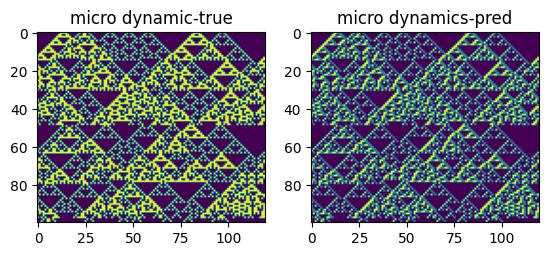

 87%|█████████████████████████████████▉     | 1739/2000 [00:52<00:06, 39.03it/s]

epoch: 1740/2000, dynamic: train loss:0.11881187309821446,valid_loss:0.11880780011415482
micro pred acc: 0.8336054421768707


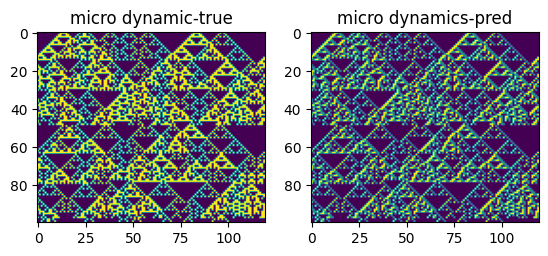

 88%|██████████████████████████████████▎    | 1759/2000 [00:53<00:06, 37.87it/s]

epoch: 1760/2000, dynamic: train loss:0.11876301715771358,valid_loss:0.11875858902931213
micro pred acc: 0.8336054421768707


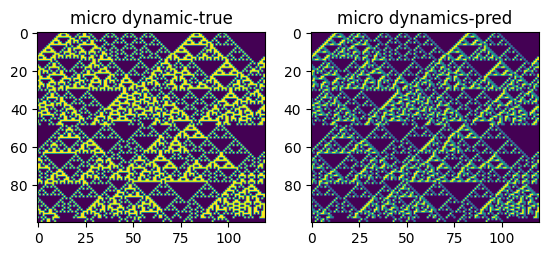

 89%|██████████████████████████████████▋    | 1779/2000 [00:53<00:05, 39.00it/s]

epoch: 1780/2000, dynamic: train loss:0.11872086425622304,valid_loss:0.11871729791164398
micro pred acc: 0.8336054421768707


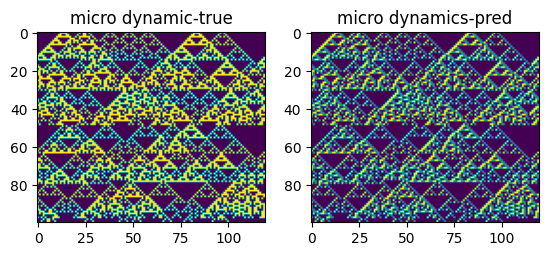

 90%|███████████████████████████████████    | 1799/2000 [00:54<00:05, 39.14it/s]

epoch: 1800/2000, dynamic: train loss:0.11864189803600311,valid_loss:0.11863911896944046
micro pred acc: 0.8336054421768707


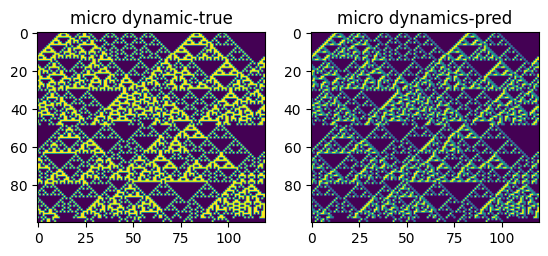

 91%|███████████████████████████████████▍   | 1819/2000 [00:55<00:04, 39.15it/s]

epoch: 1820/2000, dynamic: train loss:0.11859513074159622,valid_loss:0.11859331279993057
micro pred acc: 0.8336054421768707


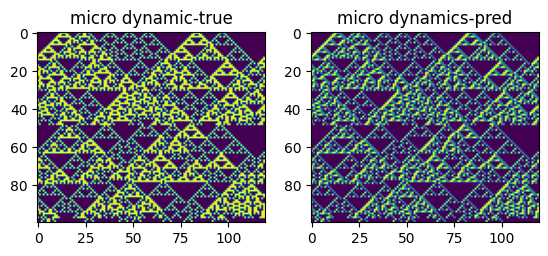

 92%|███████████████████████████████████▊   | 1839/2000 [00:55<00:04, 39.32it/s]

epoch: 1840/2000, dynamic: train loss:0.11855042229096095,valid_loss:0.11855117231607437
micro pred acc: 0.8336054421768707


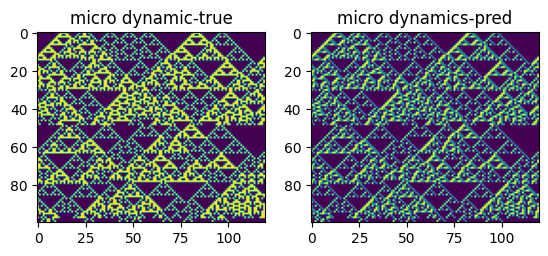

 93%|████████████████████████████████████▎  | 1859/2000 [00:56<00:03, 39.19it/s]

epoch: 1860/2000, dynamic: train loss:0.11851736903190613,valid_loss:0.11851958930492401
micro pred acc: 0.8336054421768707


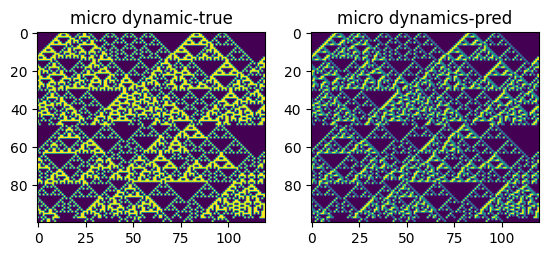

 94%|████████████████████████████████████▋  | 1879/2000 [00:56<00:03, 38.97it/s]

epoch: 1880/2000, dynamic: train loss:0.1184574415286382,valid_loss:0.11845479905605316
micro pred acc: 0.8336054421768707


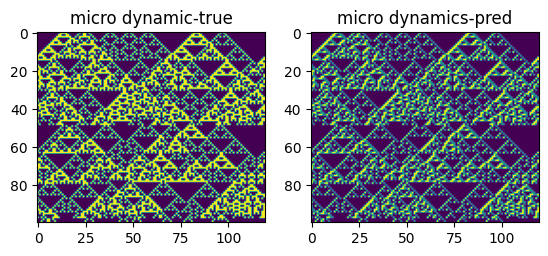

 95%|█████████████████████████████████████  | 1899/2000 [00:57<00:02, 38.55it/s]

epoch: 1900/2000, dynamic: train loss:0.11843256155649821,valid_loss:0.11842973530292511
micro pred acc: 0.8336054421768707


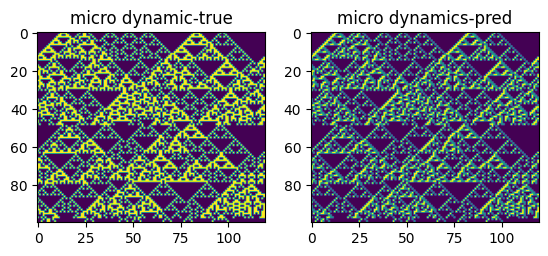

 96%|█████████████████████████████████████▍ | 1918/2000 [00:58<00:02, 35.37it/s]

epoch: 1920/2000, dynamic: train loss:0.11838675538698833,valid_loss:0.11838477104902267
micro pred acc: 0.8336054421768707


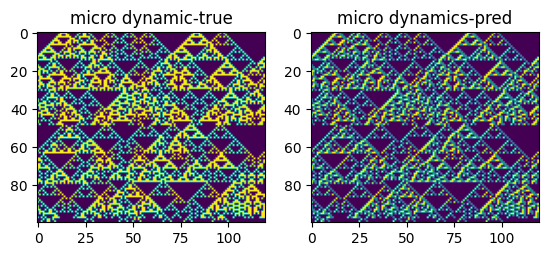

 97%|█████████████████████████████████████▊ | 1937/2000 [00:58<00:01, 36.95it/s]

epoch: 1940/2000, dynamic: train loss:0.11834396670262019,valid_loss:0.11834323406219482
micro pred acc: 0.8336054421768707


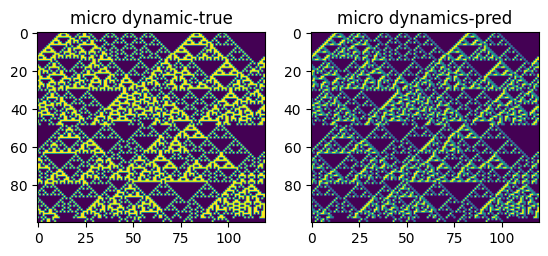

 98%|██████████████████████████████████████▏| 1956/2000 [00:59<00:01, 36.83it/s]

epoch: 1960/2000, dynamic: train loss:0.11831105500459671,valid_loss:0.11830783635377884
micro pred acc: 0.8336054421768707


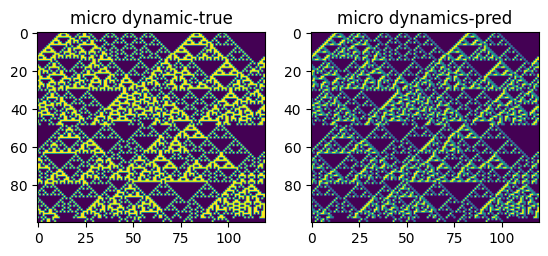

 99%|██████████████████████████████████████▌| 1976/2000 [00:59<00:00, 38.34it/s]

epoch: 1980/2000, dynamic: train loss:0.11829710255066554,valid_loss:0.11829376965761185
micro pred acc: 0.8336054421768707


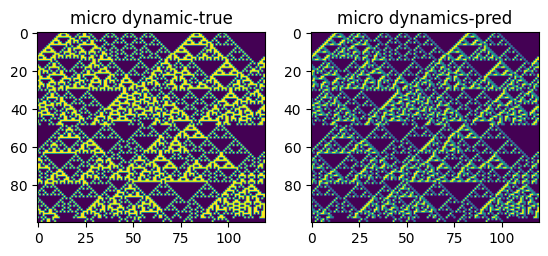

100%|███████████████████████████████████████| 2000/2000 [01:00<00:00, 33.07it/s]


In [7]:
seed = 2050
loss_F = torch.nn.NLLLoss()
# for rule in rules[:1]:
rule=90
random.seed(seed)
torch.manual_seed(seed)
print('rule:',rule)
if rule in N2_self_rules:
    print('self_similar')
# for rule in [18]:#range(100,200):
with open(f'./data/CA_data_{rule}.pkl','rb') as f:
    data = pkl.load(f)['histories'][:10,:50,:]
histories = torch.tensor(data,dtype=torch.float)
print('load data')
data_x = histories[:,:-1,:].reshape(-1,histories.shape[-1])
data_y = histories[:,1:,:].reshape(-1,histories.shape[-1])

valid_ratio = 0.2
batch_size = 90
node_size  = data_x.shape[-1]

train_data_x = data_x[:int(0.6*data_x.shape[0]),:]
train_data_y = data_y[:int(0.6*data_x.shape[0]),:]
valid_data_x = data_x[int(0.6*data_x.shape[0]):int(0.8*data_x.shape[0]),:]
valid_data_y = data_y[int(0.6*data_x.shape[0]):int(0.8*data_x.shape[0]):,:]

dataset1 = torch.utils.data.dataset.TensorDataset(train_data_x, train_data_y)
dataset2 = torch.utils.data.dataset.TensorDataset(valid_data_x, valid_data_y)

train_loader = torch.utils.data.DataLoader(dataset=dataset1,
                                           batch_size=batch_size, 
                                           shuffle=False,
                                           drop_last=True)

valid_loader = torch.utils.data.DataLoader(dataset=dataset2,
                                           batch_size=batch_size, 
                                           shuffle=False,
                                           drop_last=True)
num_epochs = 2000
channel = 5
hidden_size = 8



dynamic = DynamicLearner(channel, hidden_size)
dynamic = dynamic.cuda() if use_cuda else dynamic

optimizer1 = optim.Adam(dynamic.parameters(), lr=1e-3, weight_decay=5e-4)
dynamic.apply(init_weight)

loss_F = torch.nn.NLLLoss()
train_losses1 = []
valid_losses1 = []
train_losses2 = []
valid_losses2 = []

last_valid_loss = 1000
count = 0
'训练动力学'
for epoch in tqdm(range(num_epochs)):#重复训练num_epoch次
    loss_t1 = []
    loss_v1 = []
    dynamic.train()
    for train_x, train_y in train_loader:
        if use_cuda:
            data_x = train_x.cuda()
            data_y = train_y.cuda()
        pred = dynamic(data_x)#b*n*2
        loss_d = loss_F(torch.log(pred.view(-1,2)+NEAR_0), data_y.view(-1).long())
        optimizer1.zero_grad()
        loss_d.backward()
        optimizer1.step()
        loss_t1.append(loss_d.item())

    train_losses1.append(np.mean(loss_t1))
#         wandb.log({"train loss": np.mean(loss_t1)})
    if epoch % 20 == 0:
        dynamic.eval()
        v_loss = []
        loss1= []
        loss2=[]
        for valid_x, valid_y in valid_loader:
            if use_cuda:
                data_x = valid_x.cuda()
                data_y = valid_y.cuda()
            pred = dynamic(data_x)#b*n*2
            loss_d = loss_F(torch.log(pred.view(-1,2)+NEAR_0), data_y.view(-1).long())
            loss_v1.append(loss_d.item())
        valid_losses1.append(np.mean(loss_v1))
#             wandb.log({"train loss": np.mean(loss_v1)})
        print(f'epoch: {epoch}/{num_epochs}, dynamic: train loss:{np.mean(loss_t1)},valid_loss:{np.mean(loss_v1)}')
        if np.mean(loss_v1) > last_valid_loss:
            count += 1
            if count > 5:
                break
#                     run.finish()
        if np.mean(loss_v1) < last_valid_loss:
#                 model = dynamic
                torch.save(dynamic,f'../models/CA/{rule}_dynamic.pth')
        last_valid_loss = round(np.mean(loss_v1),10)
        preds = pred.max(2)[1]
        correct = preds.eq(data_y).double()
        correct_s = correct.sum()
        acc = correct_s / len(data_y.view(-1))
        print('micro pred acc:',acc.cpu().detach().numpy())
#         if epoch % 10 == 0:
        plt.figure(figsize=(10,4),dpi=100)
        plt.subplot(132)
        plt.title('micro dynamics-pred')
        plt.imshow(pred[:100,:,1].cpu().detach().numpy())
        plt.subplot(131)
        plt.title('micro dynamic-true')
        plt.imshow(data_y[:100,:].cpu().detach().numpy())
        plt.show()

#         torch.save(dynamic,f'../models/{rule}_dynamic_channel={channel}_hid={hidden_size}.pth')
# run.finish()